In [ ]:
# Import packages
%load_ext autoreload
%matplotlib inline
%autoreload 2

import os
import time
import random
import torch
import itertools
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets, utils
from torch.utils.data import Dataset, DataLoader
from torch.nn import init
from IPython.display import display
from PIL import Image
import numpy as np
import math
import matplotlib.pyplot as plt


In [ ]:
def norm_noise(size):
    return torch.cuda.FloatTensor(size, 100).normal_()
  
def init_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1 or classname.find('BatchNorm') != -1:
        m.weight.data.normal_(0.00, 0.02)
  
def display_batch_images(img, imtype=np.uint8, unnormalize=True, nrows=None, mean=0.5, std=0.5):
    # select a sample or create grid if img is a batch
    if len(img.shape) == 4:
        nrows = nrows if nrows is not None else int(math.sqrt(img.size(0)))
        img = utils.make_grid(img, nrow=nrows)

    # unnormalize
    img = img.cpu().float()
    img = (img*std+mean)*255

    # to numpy
    image_numpy = img.numpy()
    image_numpy = np.transpose(image_numpy, (1, 2, 0))
    display(Image.fromarray(image_numpy.astype(imtype)))

In [ ]:
# Download horse2zebra
!mkdir -p ./datasets
!wget -N https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/horse2zebra.zip -O ./datasets/horse2zebra.zip

# Unzip dataset
!unzip ./datasets/horse2zebra.zip -d ./datasets/

for details.

--2020-04-19 09:40:49--  https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/horse2zebra.zip
Resolving people.eecs.berkeley.edu (people.eecs.berkeley.edu)... 128.32.189.73
Connecting to people.eecs.berkeley.edu (people.eecs.berkeley.edu)|128.32.189.73|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 116867962 (111M) [application/zip]
Saving to: ‘./datasets/horse2zebra.zip’

./datasets/horse2ze 100%[===================>] 111.45M  92.8MB/s    in 1.2s    

2020-04-19 09:40:50 (92.8 MB/s) - ‘./datasets/horse2zebra.zip’ saved [116867962/116867962]

Archive:  ./datasets/horse2zebra.zip
   creating: ./datasets/horse2zebra/
   creating: ./datasets/horse2zebra/trainA/
  inflating: ./datasets/horse2zebra/trainA/n02381460_6223.jpg  
  inflating: ./datasets/horse2zebra/trainA/n02381460_1567.jpg  
  inflating: ./datasets/horse2zebra/trainA/n02381460_3354.jpg  
  inflating: ./datasets/horse2zebra/trainA/n02381460_299.jpg  
  inflating: ./datasets/h

In [ ]:
class TwoDatasets(Dataset):
  """
  Dataset class to get samples from two different image collections
  """
  def __init__(self, root_dirA, root_dirB, batch_size, transform= None):
    self.root_dirA = root_dirA
    self.root_dirB = root_dirB
    self.filelistA = os.listdir(self.root_dirA)
    self.filelistB = os.listdir(self.root_dirB)
    self.transform = transform
    self.batch_size = batch_size

  def __len__(self):
    if len(self.filelistA) < len(self.filelistB):
      num_img = int(len(self.filelistA)/self.batch_size) * self.batch_size
    else:
      num_img = int(len(self.filelistB)/self.batch_size) * self.batch_size
    return num_img

  def __getitem__(self,idx):
    if torch.is_tensor(idx):
      idx = idx.tolist()

    img_nameA = os.path.join(self.root_dirA, self.filelistA[idx])
    img_nameB = os.path.join(self.root_dirB, self.filelistB[idx])

    imageA = Image.open(img_nameA).convert('RGB')
    imageB = Image.open(img_nameB).convert('RGB')

    if self.transform:
      imageA = self.transform(imageA)
      imageB = self.transform(imageB)

    return imageA, imageB

In [ ]:
image_size = 128
batch_size = 10
tf_train = transforms.Compose(
    [transforms.Resize(int(image_size*1.12), interpolation=Image.BICUBIC),
     transforms.RandomHorizontalFlip(),
     transforms.CenterCrop(image_size),
     transforms.ToTensor(),
     transforms.Normalize((0.5,), (0.5,))]
    )
image_size_test = 256
batch_size_test = 1
tf_test = transforms.Compose(
    [transforms.Resize(int(image_size_test*1.12), interpolation=Image.BICUBIC),
     transforms.CenterCrop(image_size_test),
     transforms.ToTensor(),
     transforms.Normalize((0.5,), (0.5,))]
    )

# Horse2Zebra
horse2zebra_train = TwoDatasets('./datasets/horse2zebra/trainA', './datasets/horse2zebra/trainB', batch_size, transform=tf_train)
horse2zebra_test  = TwoDatasets('./datasets/horse2zebra/testA',  './datasets/horse2zebra/testB',  batch_size_test, transform=tf_test)

# Horse2Zebra
data_loader_train = torch.utils.data.DataLoader(horse2zebra_train, batch_size=batch_size, shuffle=True)
data_loader_test  = torch.utils.data.DataLoader(horse2zebra_test,  batch_size=batch_size_test, shuffle=False)

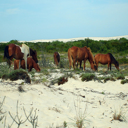

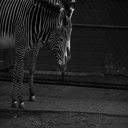

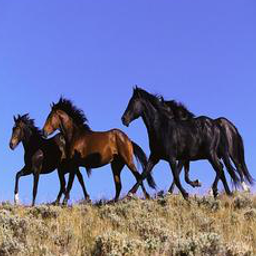

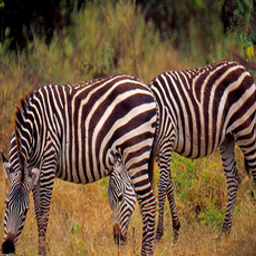

torch.Size([3, 128, 128])

In [ ]:
# Display images
display_batch_images(horse2zebra_train[0][0])
display_batch_images(horse2zebra_train[0][1])
#
display_batch_images(horse2zebra_test[0][0])
display_batch_images(horse2zebra_test[0][1])

horse2zebra_train[0][0].shape

In [ ]:
class Generator(torch.nn.Module):
    
    def __init__(self,num_resnet_blocks=5):
        super(Generator, self).__init__()
        
        self.num_resnet_blocks = num_resnet_blocks

        self._conv1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=7, stride=1, padding=3, bias=True, padding_mode='reflect'),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        self._conv2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True)
        )

        self._conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )


        self._transformation1 = self.ResNetBlock(256)
        self._transformation2 = self.ResNetBlock(256)
        self._transformation3 = self.ResNetBlock(256)
        self._transformation4 = self.ResNetBlock(256)
        self._transformation5 = self.ResNetBlock(256)
        self._transformation6 = self.ResNetBlock(256)

        self._upconv1 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1, bias=True),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True)
        )
        self._upconv2 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1, bias=True),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        self._upconv3 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=7, stride=1, padding=3, bias=True),
            nn.Tanh()
        )

    def ResNetBlock(self,input_channels,kernel=3,stride=1,padding=1):
        block = nn.Sequential(
            nn.Conv2d(in_channels=input_channels, out_channels=input_channels, kernel_size=kernel, stride=stride, padding=padding, bias=True, padding_mode='reflect'),
            nn.BatchNorm2d(input_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=input_channels, out_channels=input_channels, kernel_size=kernel, stride=stride, padding=padding, bias=True, padding_mode='reflect'),
            nn.BatchNorm2d(input_channels),
            nn.ReLU(inplace=True)
        )
        return block


    def forward(self, x):

        x = self._conv1(x)
        connection1 = x
        x = self._conv2(x)
        connection2 = x
        x = self._conv3(x)
        x = x + self._transformation1(x)
        x = x + self._transformation2(x)
        x = x + self._transformation3(x)
        x = x + self._transformation4(x)
        x = x + self._transformation5(x)
        x = x + self._transformation6(x)
        x = self._upconv1(x)
        x = x + connection2
        x = self._upconv2(x)
        x = x + connection1
        out = self._upconv3(x)

        return out
        

In [ ]:
class Discriminator(torch.nn.Module):
    
    def __init__(self):
        super(Discriminator, self).__init__()

        self._conv1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1, bias=True),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self._conv2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self._conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self._conv4 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        self._conv5 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=1, bias=True),
        )

    def forward(self, x):
        
        x = self._conv1(x)
        x = self._conv2(x)
        x = self._conv3(x)
        x = self._conv4(x)
        out = self._conv5(x)

        return out

In [ ]:
class Model:
    # --------------------------
    # -- PREPARE MODEL
    # --------------------------
    
    def __init__(self, batch_size, lambda_cyclic, lambda_identity):
        self.lambda_cyclic = lambda_cyclic
        self.lambda_identity = lambda_identity
        self._create_networks()
        self._create_optimizer()
        self._init_criterion(batch_size)
        
    def _create_networks(self):
        # create networks
        self._generator_AB = Generator()
        self._generator_BA = Generator()
        self._discriminator_A = Discriminator()
        self._discriminator_B = Discriminator()
        
        # init weights
        self._generator_AB.apply(init_weights)
        self._generator_BA.apply(init_weights)
        self._discriminator_A.apply(init_weights)
        self._discriminator_B.apply(init_weights)
        
        # move to cuda
        self._generator_AB.cuda()
        self._generator_BA.cuda()
        self._discriminator_A.cuda()
        self._discriminator_B.cuda()
        
    def _create_optimizer(self):
        # generator optimizer
        self._opt_g = torch.optim.Adam(
            itertools.chain(self._generator_AB.parameters(), self._generator_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
        )

        # discriminators optimizers
        self._opt_d = torch.optim.Adam(
            itertools.chain(self._discriminator_A.parameters(), self._discriminator_B.parameters()), lr=0.0002, betas=(0.5, 0.999)
        )
        
    def _init_criterion(self, batch_size):
        self._criterionGAN = nn.MSELoss() # To fight vanishing gradients better MSELoss than BCELoss
        self._criterionCYC = nn.L1Loss()  # L1 for Cycle Consistency Loss
        self._criterionIDT = nn.L1Loss()  # L1 for Identity Loss
        #####
        size_out = 14 # 14 for images 128x128 and 30 for images 256x256
        #####
        self._label_real = Variable(torch.ones(batch_size, 1, size_out, size_out)).cuda()
        self._label_fake = Variable(torch.zeros(batch_size, 1, size_out, size_out)).cuda()
    
    # --------------------------
    # -- Optimize Model
    # --------------------------

    def step_optimization(self, real_samples_A, real_samples_B):  

        # optimize generator
        loss_g, generated_A2B, generated_B2A = self._step_opt_g(real_samples_A,real_samples_B,self.lambda_cyclic,self.lambda_identity)
        
        # optimize discriminator
        loss_d_real, loss_d_fake = self._step_opt_d(real_samples_A,real_samples_B,generated_A2B.detach(), generated_B2A.detach())
        
        return loss_g, loss_d_real, loss_d_fake
      
    def _step_opt_g(self, real_samples_A, real_samples_B,lambda_cyclic,lambda_identity):

        self._opt_g.zero_grad()

        for params in self._discriminator_A.parameters():
            params.requires_grad = False
        for params in self._discriminator_B.parameters():
            params.requires_grad = False
        
        generated_A2B = self._generator_AB(real_samples_A)
        generated_B2A = self._generator_BA(real_samples_B)

        cyclic_generated_B = self._generator_AB(generated_B2A)
        cyclic_generated_A = self._generator_BA(generated_A2B)

        #idt_samplesA = self._generator_AB(real_samples_B)
        #idt_samplesB = self._generator_BA(real_samples_A)

        discriminator_generated_A = self._discriminator_A(generated_B2A)
        discriminator_generated_B = self._discriminator_B(generated_A2B)

        discriminator_real_A = self._discriminator_A(real_samples_A)
        discriminator_real_B = self._discriminator_B(real_samples_B)

        loss_generated_A = self._criterionGAN(discriminator_generated_A,self._label_real)
        loss_generated_B = self._criterionGAN(discriminator_generated_B,self._label_real)
                
        loss_cyclic_A = self._criterionCYC(cyclic_generated_A,real_samples_A)*lambda_cyclic
        loss_cyclic_B = self._criterionCYC(cyclic_generated_B,real_samples_B)*lambda_cyclic

        #loss_idt_A = self._criterionIDT(idt_samplesA,real_samples_B)*lambda_identity
        #loss_idt_B = self._criterionIDT(idt_samplesB,real_samples_A)*lambda_identity

        loss_g = loss_generated_A + loss_generated_B + loss_cyclic_A + loss_cyclic_B #+ loss_idt_A + loss_idt_B

        loss_g.backward()

        self._opt_g.step()
        
        return loss_g.item(), generated_A2B, generated_B2A
        
    def _step_opt_d(self, real_samples_A,real_samples_B,generated_A2B, generated_B2A):
        # Reset gradients
        self._opt_d.zero_grad()

        for params in self._discriminator_A.parameters():
            params.requires_grad = True
        for params in self._discriminator_B.parameters():
            params.requires_grad = True

        discriminator_generated_A = self._discriminator_A(generated_B2A)
        discriminator_generated_B = self._discriminator_B(generated_A2B)

        discriminator_real_A = self._discriminator_A(real_samples_A)
        discriminator_real_B = self._discriminator_B(real_samples_B)

        loss_generated_A = self._criterionGAN(discriminator_generated_A,self._label_fake)
        loss_generated_B = self._criterionGAN(discriminator_generated_B,self._label_fake)

        loss_real_A = self._criterionGAN(discriminator_real_A,self._label_real)
        loss_real_B = self._criterionGAN(discriminator_real_B,self._label_real)

        loss_real = (loss_real_A + loss_real_B)/2
        loss_generated = (loss_generated_A + loss_generated_B)/2

        loss_real.backward()
        loss_generated.backward()

        # Update weights
        self._opt_d.step()

        return loss_real.item(), loss_generated.item()

In [ ]:
# Set hyperparameters
num_epochs = 200               # Number of epochs
lambda_cyc = 10                # Lambda for cyclic loss
lambda_idt = lambda_cyc * 0.5  # Lambda for identity loss 
output_test_images = False      # Output of images from test dataset (True or False)
output_test_epoch = 10         # Frequency of epochs to output test images
load_model = False             # Load previous saved model (True or False)
save_epoch = 5

model = Model(batch_size,lambda_cyclic=lambda_cyc,lambda_identity=lambda_idt)

epoch: 0/200, batch: 106/106
       Generator loss: 4.158318519592285, Discriminator real loss: 0.20155012607574463, Discriminator fake loss: 0.11255605518817902
Time taken (s): 43.5155131816864
epoch: 1/200, batch: 106/106
       Generator loss: 4.171994209289551, Discriminator real loss: 0.05648452416062355, Discriminator fake loss: 0.159432515501976
Time taken (s): 43.29869198799133
epoch: 2/200, batch: 106/106
       Generator loss: 3.1419825553894043, Discriminator real loss: 0.19831043481826782, Discriminator fake loss: 0.2037932574748993
Time taken (s): 43.24583172798157
epoch: 3/200, batch: 106/106
       Generator loss: 2.9088244438171387, Discriminator real loss: 0.2807568311691284, Discriminator fake loss: 0.25921422243118286
Time taken (s): 43.2472243309021
epoch: 4/200, batch: 106/106
       Generator loss: 2.678637981414795, Discriminator real loss: 0.16467773914337158, Discriminator fake loss: 0.24946942925453186
Time taken (s): 43.25303411483765
REAL A


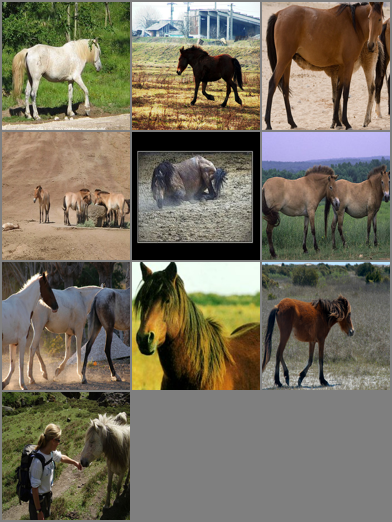

GENERATED B


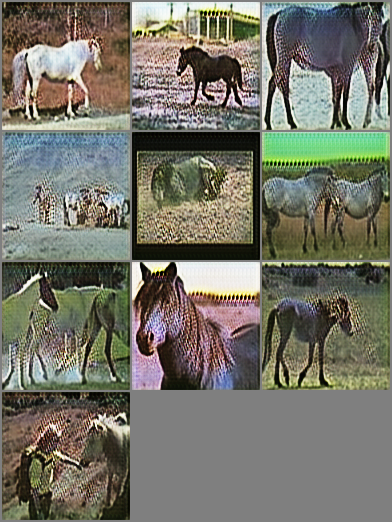

RECONSTRUCTED A


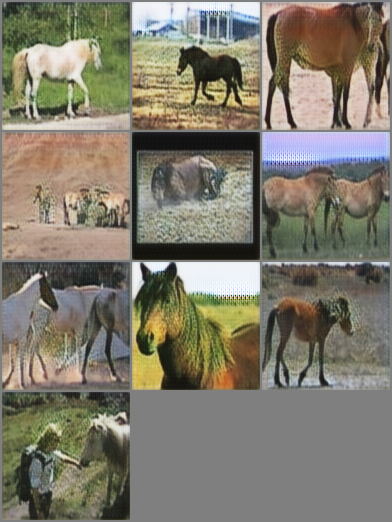

REAL B


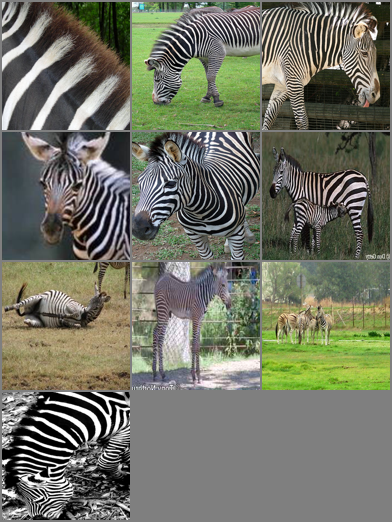

GENERATED A


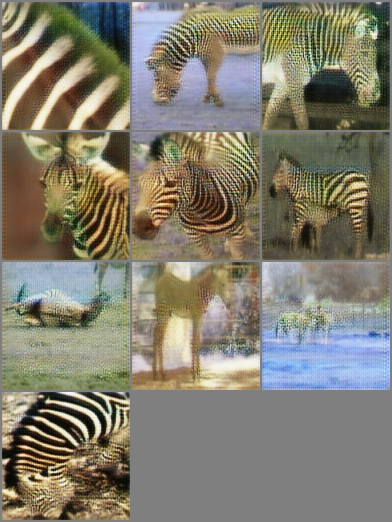

RECONSTRUCTED B


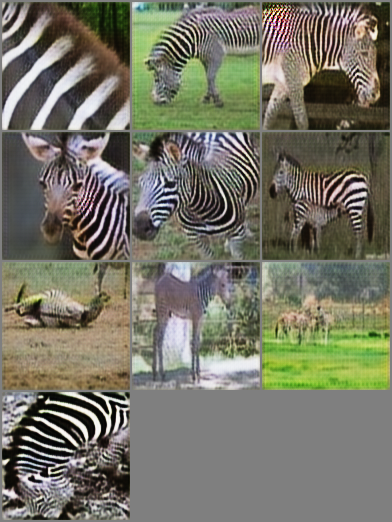

epoch: 5/200, batch: 106/106
       Generator loss: 3.169290542602539, Discriminator real loss: 0.24704235792160034, Discriminator fake loss: 0.19153118133544922
Time taken (s): 43.8132860660553
epoch: 6/200, batch: 106/106
       Generator loss: 2.39106822013855, Discriminator real loss: 0.1605549156665802, Discriminator fake loss: 0.23505879938602448
Time taken (s): 43.243797302246094
epoch: 7/200, batch: 106/106
       Generator loss: 3.395627737045288, Discriminator real loss: 0.41130393743515015, Discriminator fake loss: 0.10852392017841339
Time taken (s): 43.21103572845459
epoch: 8/200, batch: 106/106
       Generator loss: 2.9842066764831543, Discriminator real loss: 0.2583770751953125, Discriminator fake loss: 0.1752091646194458
Time taken (s): 43.208346366882324
epoch: 9/200, batch: 106/106
       Generator loss: 3.646822452545166, Discriminator real loss: 0.2359713912010193, Discriminator fake loss: 0.21796752512454987
Time taken (s): 43.11937069892883
REAL A


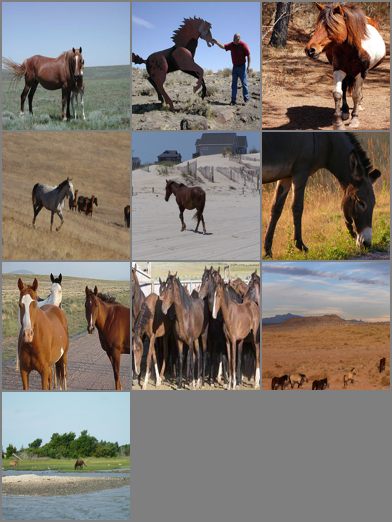

GENERATED B


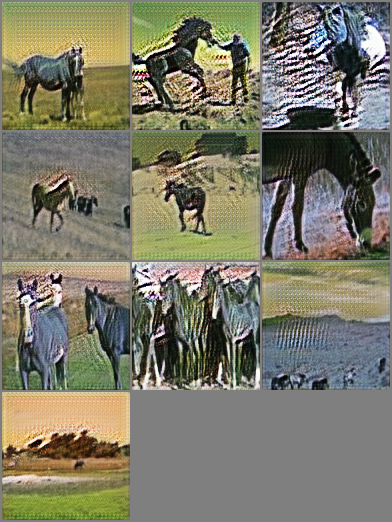

RECONSTRUCTED A


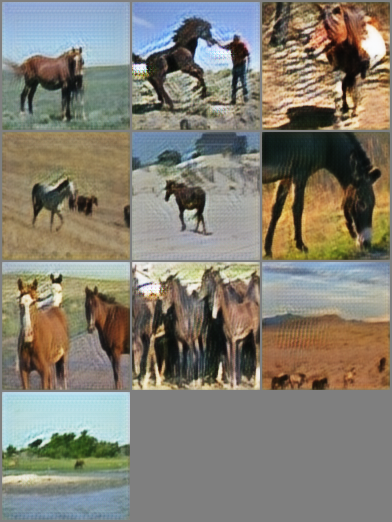

REAL B


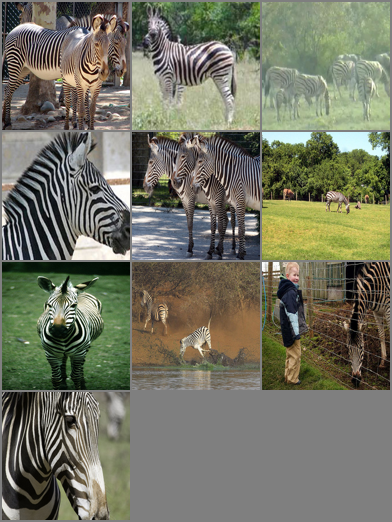

GENERATED A


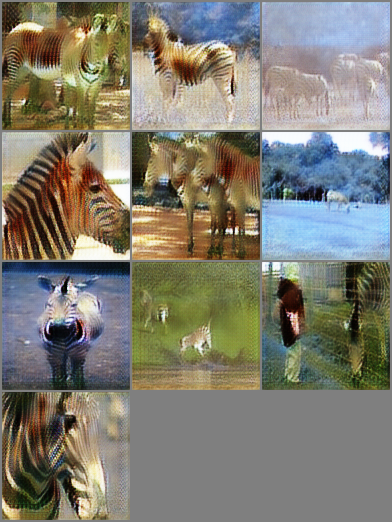

RECONSTRUCTED B


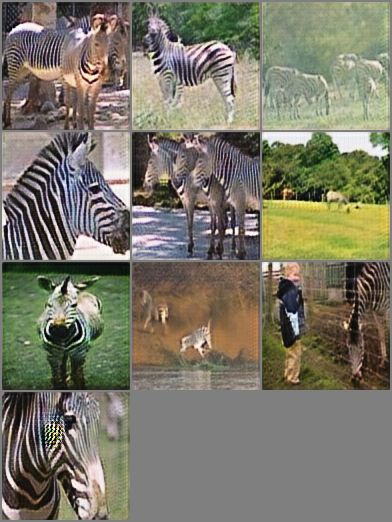

epoch: 10/200, batch: 106/106
       Generator loss: 2.337709903717041, Discriminator real loss: 0.3043570816516876, Discriminator fake loss: 0.20887193083763123
Time taken (s): 43.78718566894531
epoch: 11/200, batch: 106/106
       Generator loss: 3.0465362071990967, Discriminator real loss: 0.20482327044010162, Discriminator fake loss: 0.17266280949115753
Time taken (s): 43.08008694648743
epoch: 12/200, batch: 106/106
       Generator loss: 2.7124297618865967, Discriminator real loss: 0.1893582046031952, Discriminator fake loss: 0.2446286678314209
Time taken (s): 43.13631820678711
epoch: 13/200, batch: 106/106
       Generator loss: 2.830620050430298, Discriminator real loss: 0.21728774905204773, Discriminator fake loss: 0.18959659337997437
Time taken (s): 43.09205222129822
epoch: 14/200, batch: 106/106
       Generator loss: 3.2805986404418945, Discriminator real loss: 0.143900066614151, Discriminator fake loss: 0.23220962285995483
Time taken (s): 43.173604249954224
REAL A


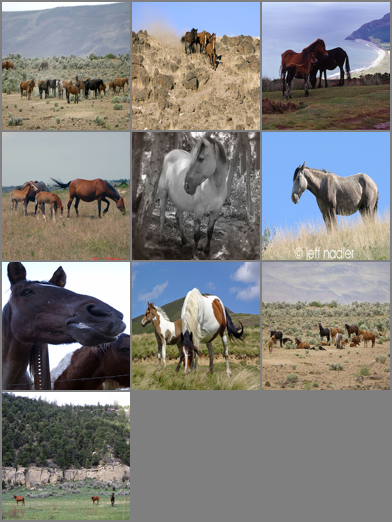

GENERATED B


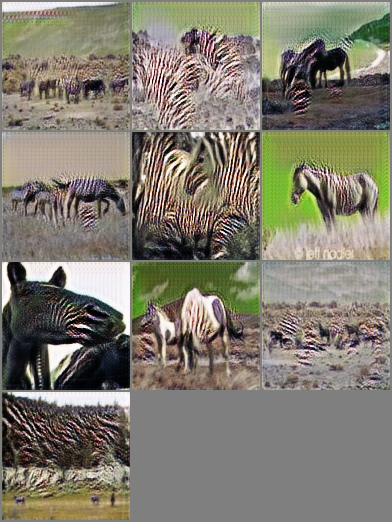

RECONSTRUCTED A


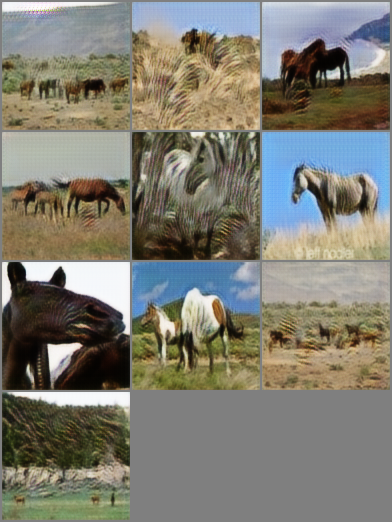

REAL B


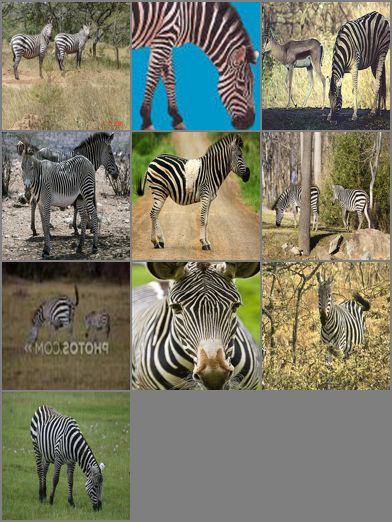

GENERATED A


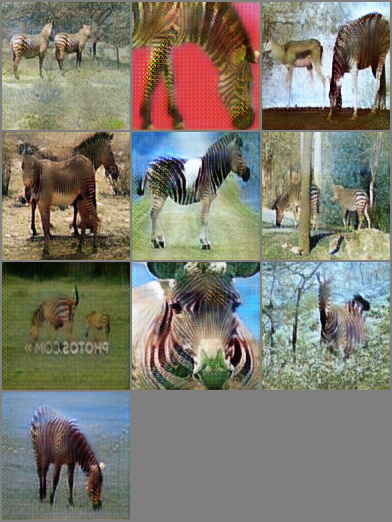

RECONSTRUCTED B


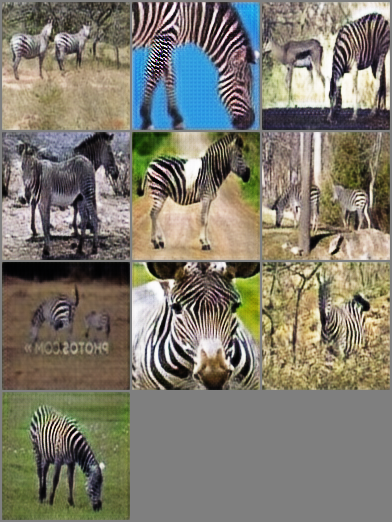

epoch: 15/200, batch: 106/106
       Generator loss: 2.4026598930358887, Discriminator real loss: 0.20112425088882446, Discriminator fake loss: 0.2580203115940094
Time taken (s): 43.701054096221924
epoch: 16/200, batch: 106/106
       Generator loss: 2.6392886638641357, Discriminator real loss: 0.18977512419223785, Discriminator fake loss: 0.13786745071411133
Time taken (s): 43.149463415145874
epoch: 17/200, batch: 106/106
       Generator loss: 2.4827632904052734, Discriminator real loss: 0.256294846534729, Discriminator fake loss: 0.19217246770858765
Time taken (s): 43.108559131622314
epoch: 18/200, batch: 106/106
       Generator loss: 3.225769519805908, Discriminator real loss: 0.2749116122722626, Discriminator fake loss: 0.22770869731903076
Time taken (s): 43.104740619659424
epoch: 19/200, batch: 106/106
       Generator loss: 3.1740825176239014, Discriminator real loss: 0.222234845161438, Discriminator fake loss: 0.2142353355884552
Time taken (s): 43.08490610122681
REAL A


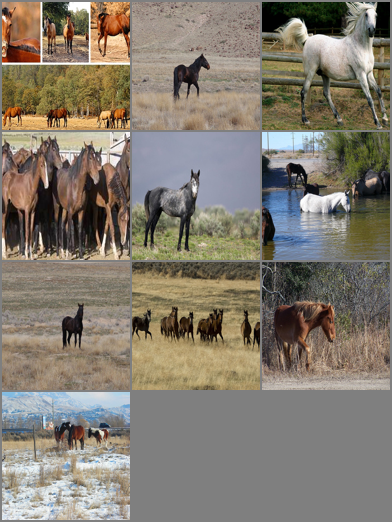

GENERATED B


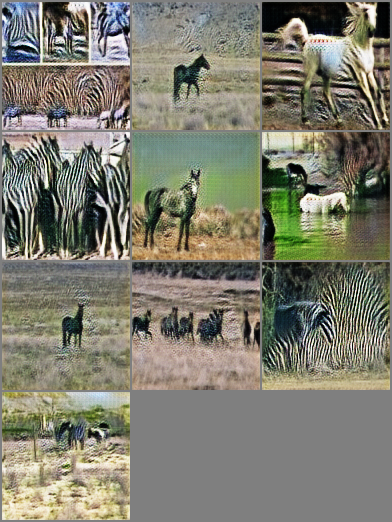

RECONSTRUCTED A


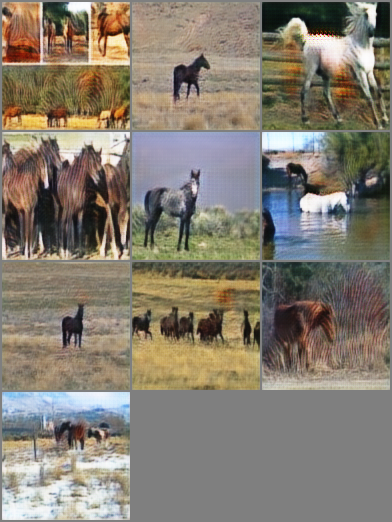

REAL B


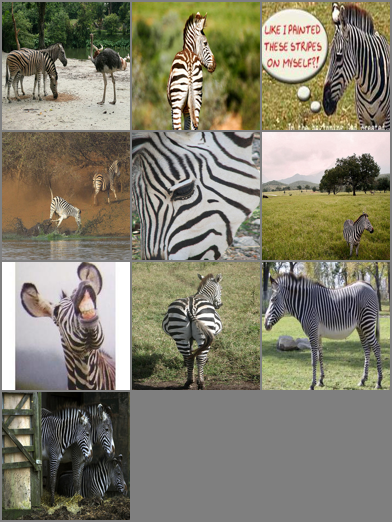

GENERATED A


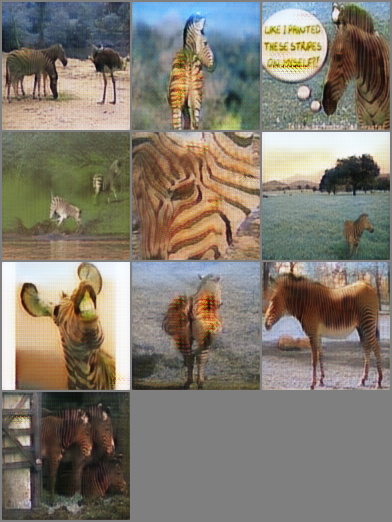

RECONSTRUCTED B


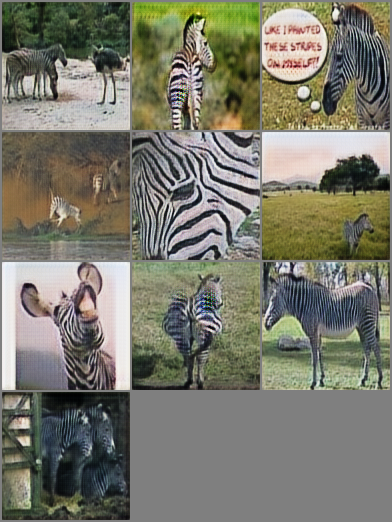

epoch: 20/200, batch: 106/106
       Generator loss: 2.714204788208008, Discriminator real loss: 0.22415079176425934, Discriminator fake loss: 0.23416171967983246
Time taken (s): 43.7311794757843
epoch: 21/200, batch: 106/106
       Generator loss: 2.4337856769561768, Discriminator real loss: 0.15079224109649658, Discriminator fake loss: 0.23948156833648682
Time taken (s): 43.205448150634766
epoch: 22/200, batch: 106/106
       Generator loss: 2.4953317642211914, Discriminator real loss: 0.09424944221973419, Discriminator fake loss: 0.24239510297775269
Time taken (s): 43.07420539855957
epoch: 23/200, batch: 106/106
       Generator loss: 3.5756702423095703, Discriminator real loss: 0.256897896528244, Discriminator fake loss: 0.14475706219673157
Time taken (s): 43.11336612701416
epoch: 24/200, batch: 106/106
       Generator loss: 2.385904550552368, Discriminator real loss: 0.19363951683044434, Discriminator fake loss: 0.30639469623565674
Time taken (s): 43.09043002128601
REAL A


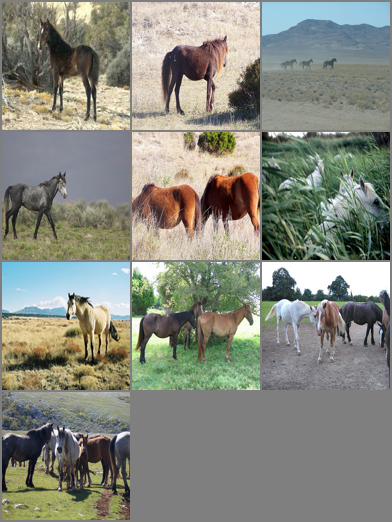

GENERATED B


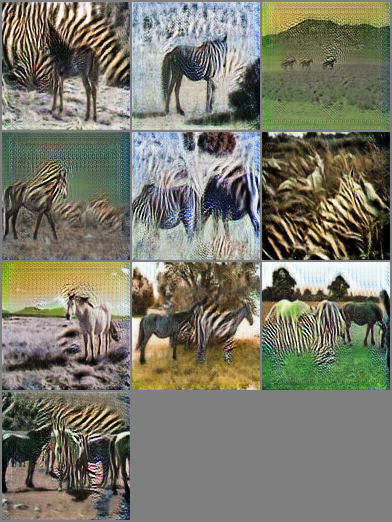

RECONSTRUCTED A


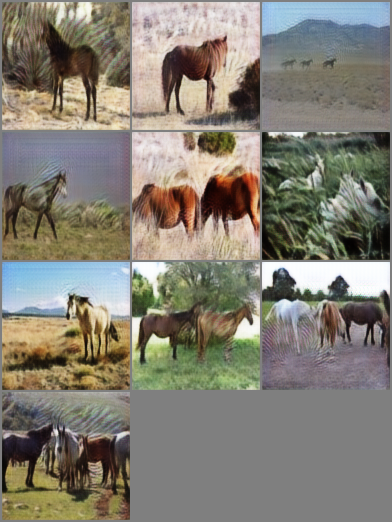

REAL B


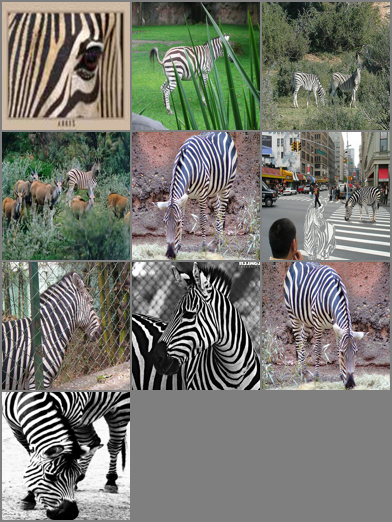

GENERATED A


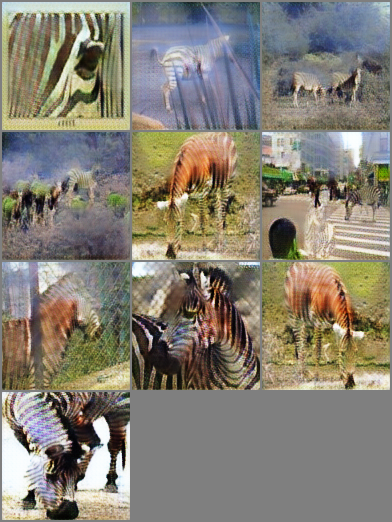

RECONSTRUCTED B


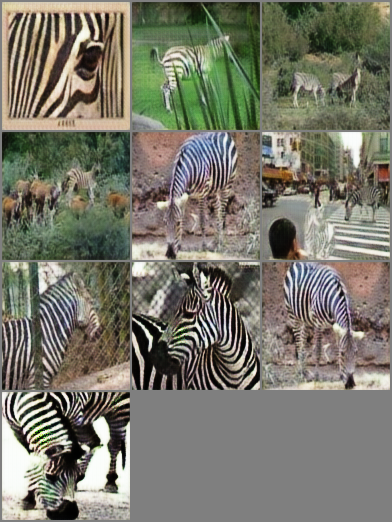

epoch: 25/200, batch: 106/106
       Generator loss: 2.9178500175476074, Discriminator real loss: 0.2303544580936432, Discriminator fake loss: 0.14352966845035553
Time taken (s): 43.69107246398926
epoch: 26/200, batch: 106/106
       Generator loss: 3.4384045600891113, Discriminator real loss: 0.0861721858382225, Discriminator fake loss: 0.0784938633441925
Time taken (s): 43.04862570762634
epoch: 27/200, batch: 106/106
       Generator loss: 2.8484396934509277, Discriminator real loss: 0.25050777196884155, Discriminator fake loss: 0.18339499831199646
Time taken (s): 43.119844913482666
epoch: 28/200, batch: 106/106
       Generator loss: 2.818293333053589, Discriminator real loss: 0.31097784638404846, Discriminator fake loss: 0.1486540138721466
Time taken (s): 43.12336325645447
epoch: 29/200, batch: 106/106
       Generator loss: 3.1874032020568848, Discriminator real loss: 0.08135269582271576, Discriminator fake loss: 0.07702693343162537
Time taken (s): 43.056639671325684
REAL A


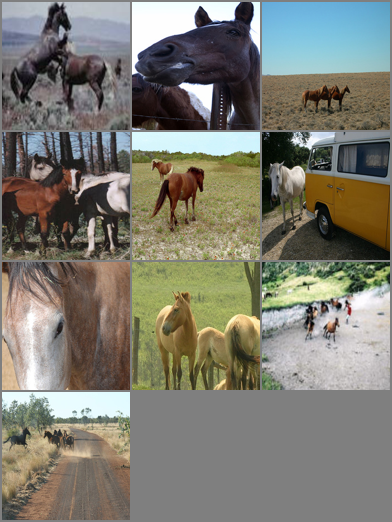

GENERATED B


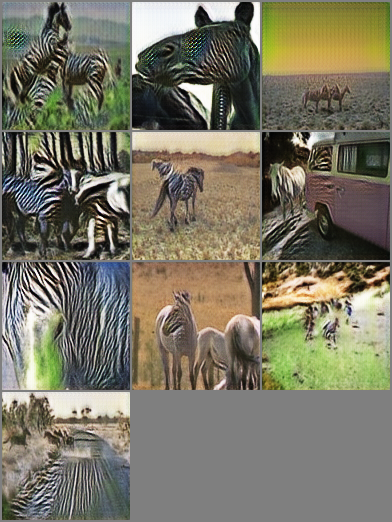

RECONSTRUCTED A


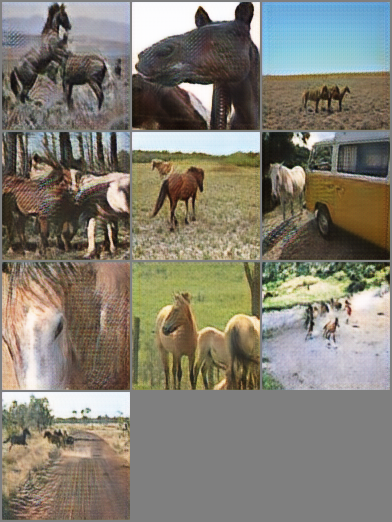

REAL B


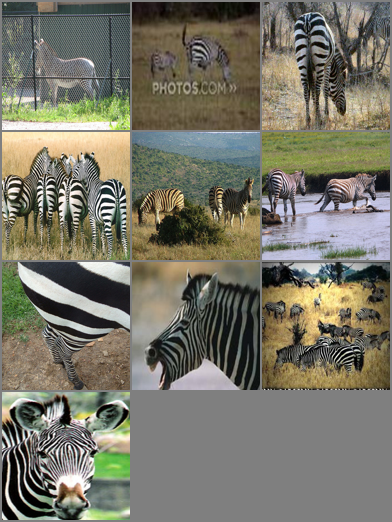

GENERATED A


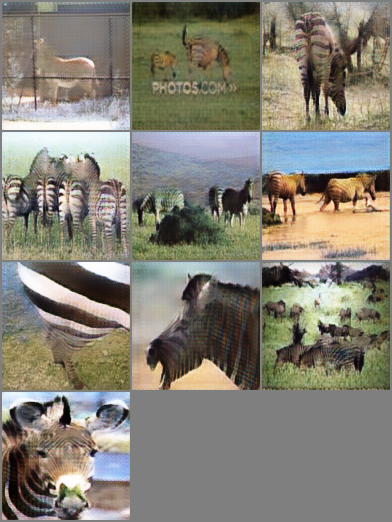

RECONSTRUCTED B


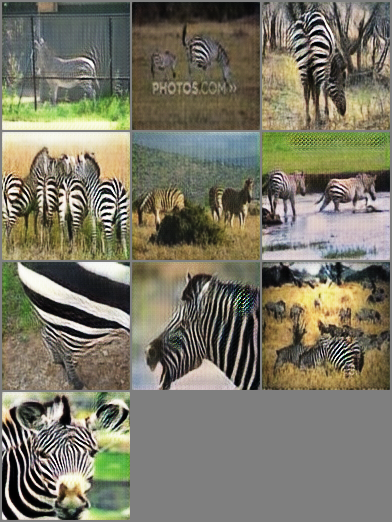

epoch: 30/200, batch: 106/106
       Generator loss: 2.0892422199249268, Discriminator real loss: 0.1901000440120697, Discriminator fake loss: 0.30456942319869995
Time taken (s): 43.647555112838745
epoch: 31/200, batch: 106/106
       Generator loss: 2.2516376972198486, Discriminator real loss: 0.22438636422157288, Discriminator fake loss: 0.2717479169368744
Time taken (s): 43.076664209365845
epoch: 32/200, batch: 106/106
       Generator loss: 2.423551321029663, Discriminator real loss: 0.27422985434532166, Discriminator fake loss: 0.14962507784366608
Time taken (s): 43.08116102218628
epoch: 33/200, batch: 106/106
       Generator loss: 2.595938205718994, Discriminator real loss: 0.1588316559791565, Discriminator fake loss: 0.17360875010490417
Time taken (s): 43.09769320487976
epoch: 34/200, batch: 106/106
       Generator loss: 2.380967140197754, Discriminator real loss: 0.11365486681461334, Discriminator fake loss: 0.23177489638328552
Time taken (s): 43.06370520591736
REAL A


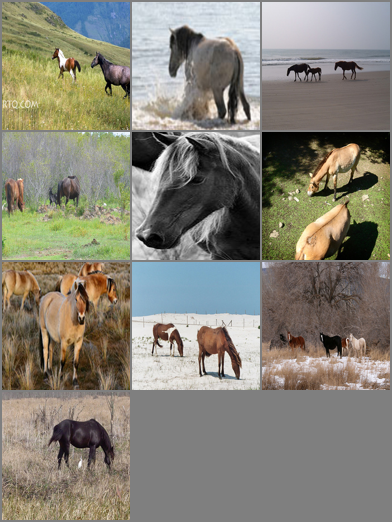

GENERATED B


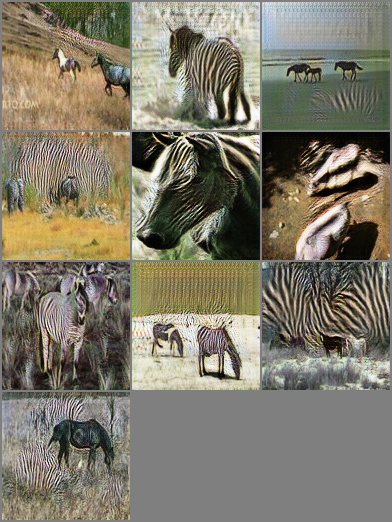

RECONSTRUCTED A


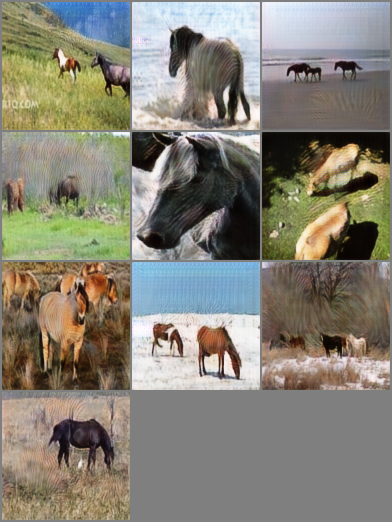

REAL B


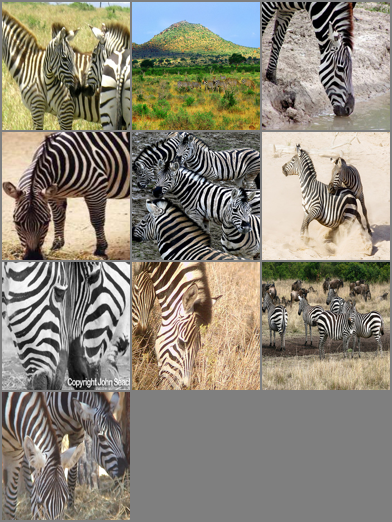

GENERATED A


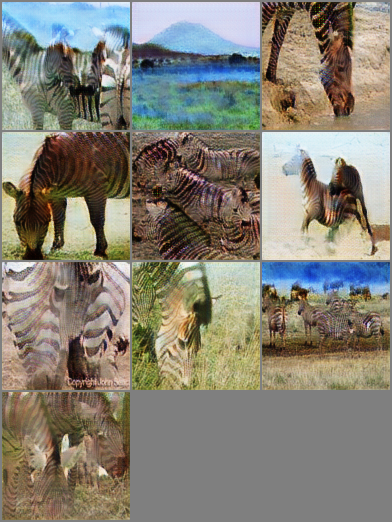

RECONSTRUCTED B


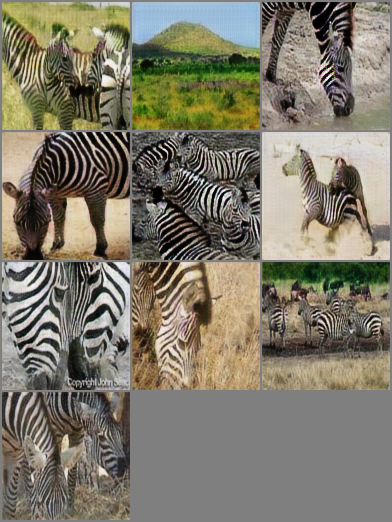

epoch: 35/200, batch: 106/106
       Generator loss: 2.1771483421325684, Discriminator real loss: 0.1377098113298416, Discriminator fake loss: 0.2438127100467682
Time taken (s): 43.75632071495056
epoch: 36/200, batch: 106/106
       Generator loss: 2.5271406173706055, Discriminator real loss: 0.06380869448184967, Discriminator fake loss: 0.2005710005760193
Time taken (s): 43.054407596588135
epoch: 37/200, batch: 106/106
       Generator loss: 2.7301366329193115, Discriminator real loss: 0.2648896872997284, Discriminator fake loss: 0.15642018616199493
Time taken (s): 43.04017353057861
epoch: 38/200, batch: 106/106
       Generator loss: 2.47700834274292, Discriminator real loss: 0.15101847052574158, Discriminator fake loss: 0.1646258682012558
Time taken (s): 43.109703540802
epoch: 39/200, batch: 106/106
       Generator loss: 2.4760019779205322, Discriminator real loss: 0.11175243556499481, Discriminator fake loss: 0.2975120544433594
Time taken (s): 43.027458906173706
REAL A


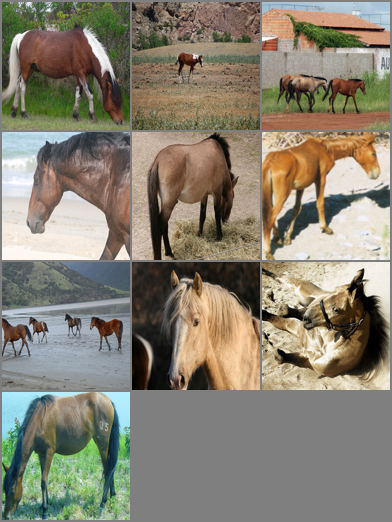

GENERATED B


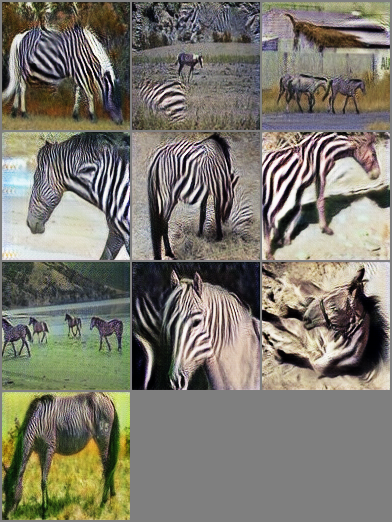

RECONSTRUCTED A


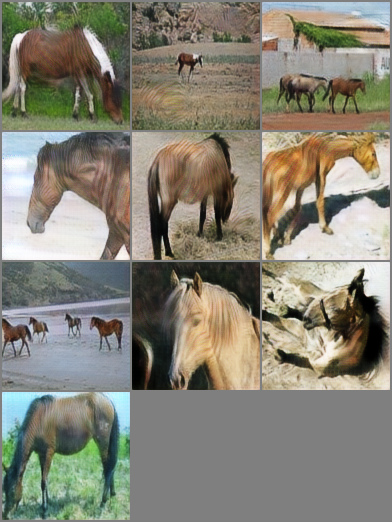

REAL B


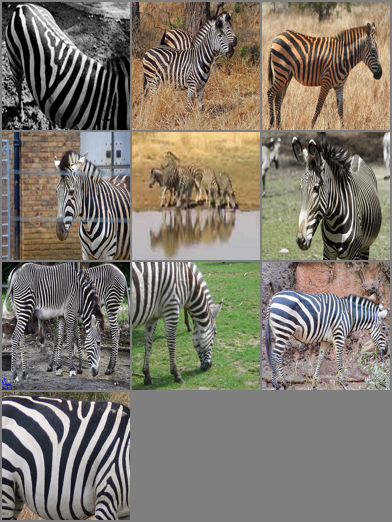

GENERATED A


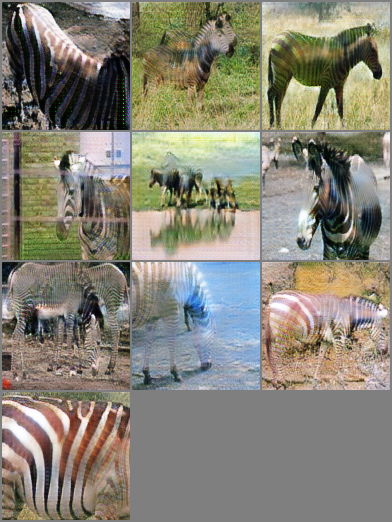

RECONSTRUCTED B


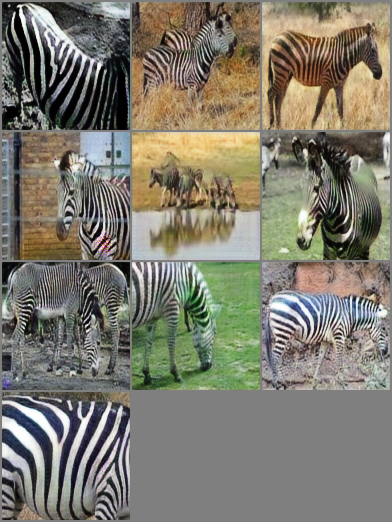

epoch: 40/200, batch: 106/106
       Generator loss: 2.7563374042510986, Discriminator real loss: 0.15880483388900757, Discriminator fake loss: 0.16827388107776642
Time taken (s): 43.71106195449829
epoch: 41/200, batch: 106/106
       Generator loss: 2.5137548446655273, Discriminator real loss: 0.08130142092704773, Discriminator fake loss: 0.19164514541625977
Time taken (s): 43.03997254371643
epoch: 42/200, batch: 106/106
       Generator loss: 2.565641164779663, Discriminator real loss: 0.21512752771377563, Discriminator fake loss: 0.19405609369277954
Time taken (s): 43.15158128738403
epoch: 43/200, batch: 106/106
       Generator loss: 2.6052565574645996, Discriminator real loss: 0.3488045930862427, Discriminator fake loss: 0.19137176871299744
Time taken (s): 43.02009916305542
epoch: 44/200, batch: 106/106
       Generator loss: 2.50447154045105, Discriminator real loss: 0.20663172006607056, Discriminator fake loss: 0.1927337944507599
Time taken (s): 43.02498817443848
REAL A


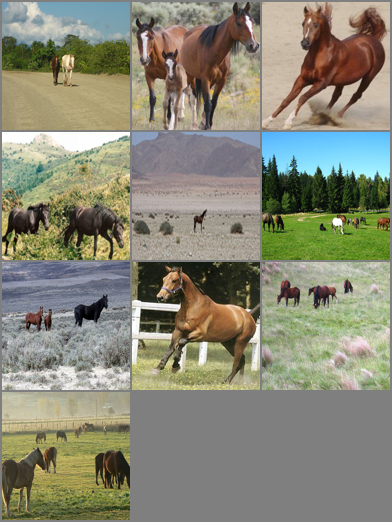

GENERATED B


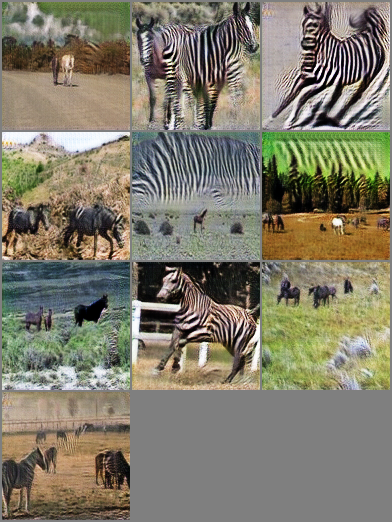

RECONSTRUCTED A


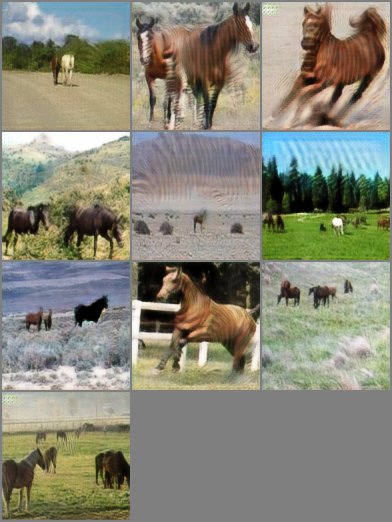

REAL B


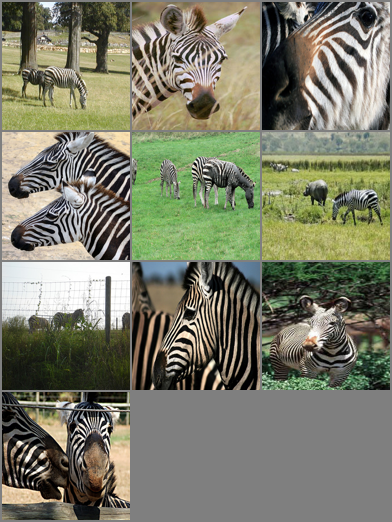

GENERATED A


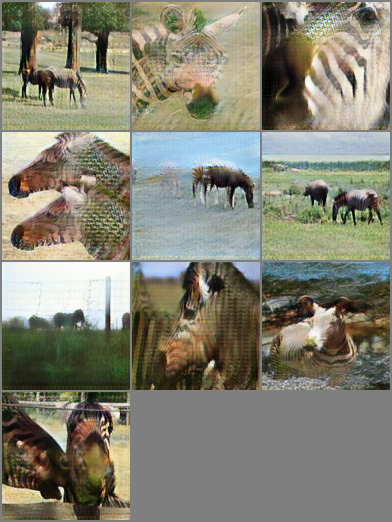

RECONSTRUCTED B


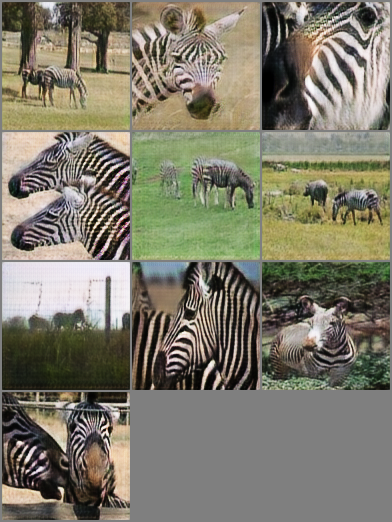

epoch: 45/200, batch: 106/106
       Generator loss: 2.7494406700134277, Discriminator real loss: 0.29815903306007385, Discriminator fake loss: 0.19628852605819702
Time taken (s): 43.68180203437805
epoch: 46/200, batch: 106/106
       Generator loss: 2.312990665435791, Discriminator real loss: 0.11565549671649933, Discriminator fake loss: 0.3204023540019989
Time taken (s): 43.03268265724182
epoch: 47/200, batch: 106/106
       Generator loss: 2.4826650619506836, Discriminator real loss: 0.13417956233024597, Discriminator fake loss: 0.15221767127513885
Time taken (s): 43.04011583328247
epoch: 48/200, batch: 106/106
       Generator loss: 2.5100109577178955, Discriminator real loss: 0.11836230754852295, Discriminator fake loss: 0.17093870043754578
Time taken (s): 43.04879689216614
epoch: 49/200, batch: 106/106
       Generator loss: 2.4265530109405518, Discriminator real loss: 0.12223652005195618, Discriminator fake loss: 0.16008612513542175
Time taken (s): 43.09076285362244
REAL A


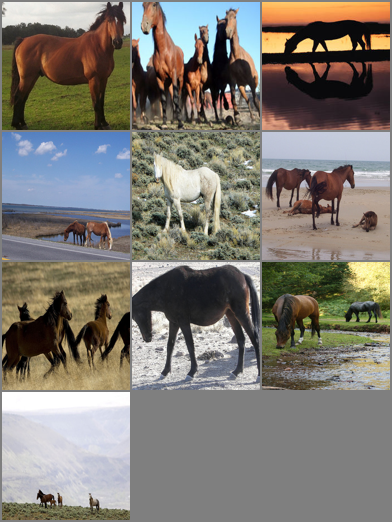

GENERATED B


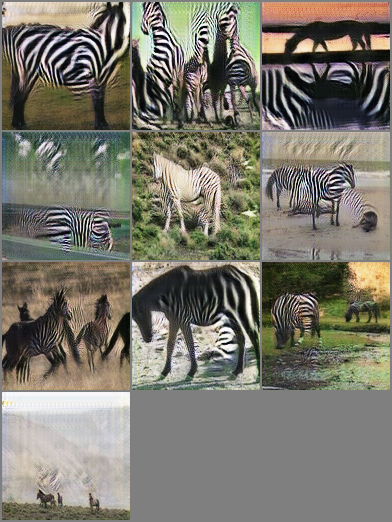

RECONSTRUCTED A


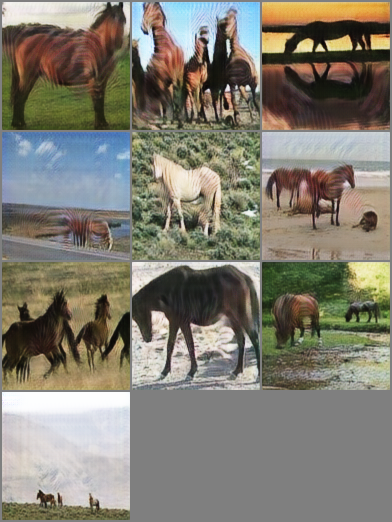

REAL B


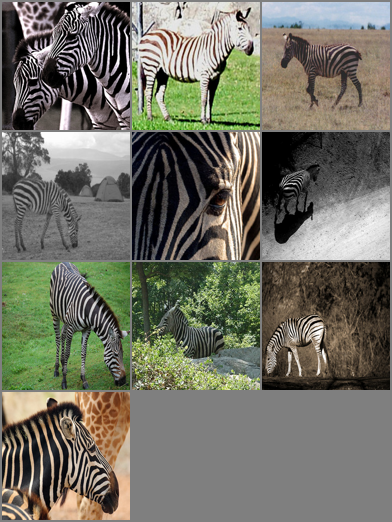

GENERATED A


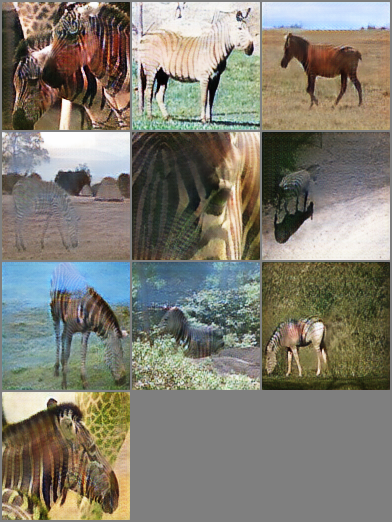

RECONSTRUCTED B


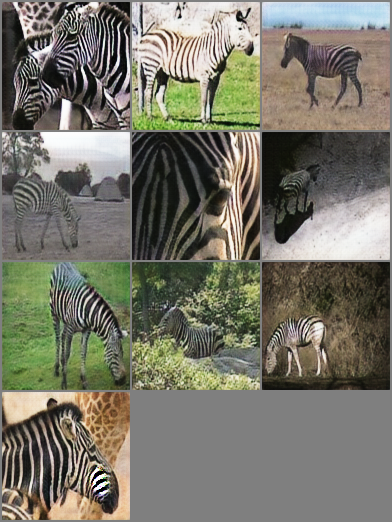

epoch: 50/200, batch: 106/106
       Generator loss: 2.5707359313964844, Discriminator real loss: 0.1557263433933258, Discriminator fake loss: 0.24469569325447083
Time taken (s): 43.58954167366028
epoch: 51/200, batch: 106/106
       Generator loss: 2.3917765617370605, Discriminator real loss: 0.14588192105293274, Discriminator fake loss: 0.37769877910614014
Time taken (s): 43.051551818847656
epoch: 52/200, batch: 106/106
       Generator loss: 2.4332103729248047, Discriminator real loss: 0.16927337646484375, Discriminator fake loss: 0.20702287554740906
Time taken (s): 43.061362981796265
epoch: 53/200, batch: 106/106
       Generator loss: 2.673030138015747, Discriminator real loss: 0.12470237910747528, Discriminator fake loss: 0.108194500207901
Time taken (s): 43.04246687889099
epoch: 54/200, batch: 106/106
       Generator loss: 2.357436180114746, Discriminator real loss: 0.2414451539516449, Discriminator fake loss: 0.2502676844596863
Time taken (s): 42.985357999801636
REAL A


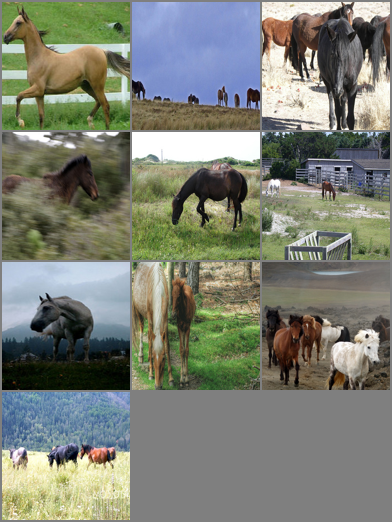

GENERATED B


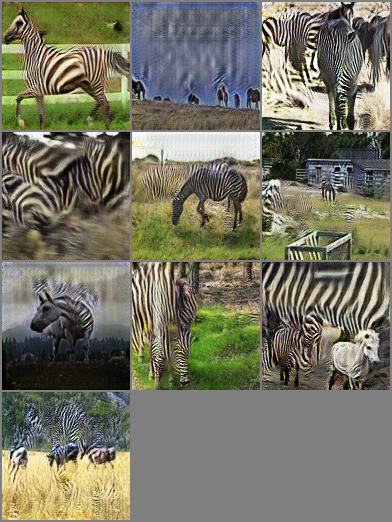

RECONSTRUCTED A


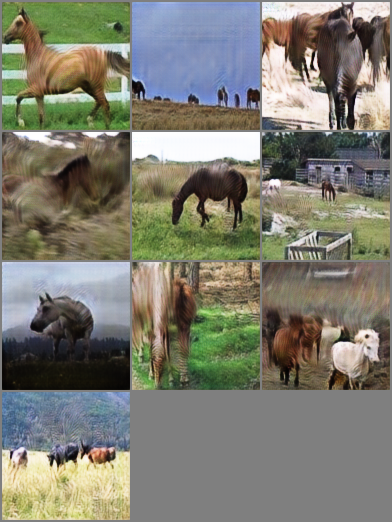

REAL B


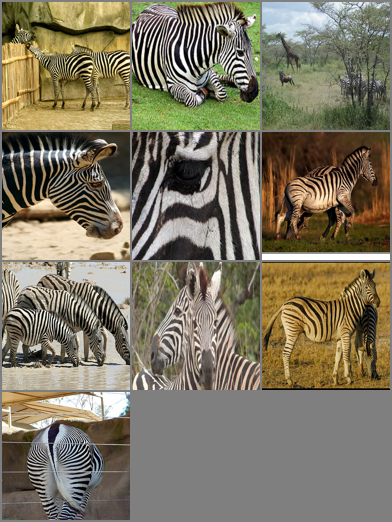

GENERATED A


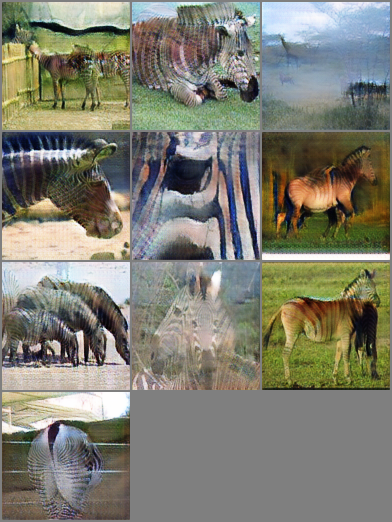

RECONSTRUCTED B


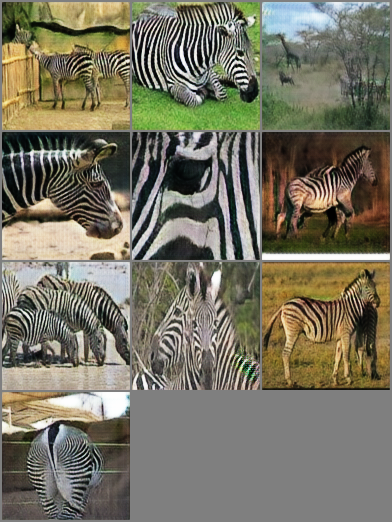

epoch: 55/200, batch: 106/106
       Generator loss: 2.6188924312591553, Discriminator real loss: 0.10557188093662262, Discriminator fake loss: 0.17650100588798523
Time taken (s): 43.65073561668396
epoch: 56/200, batch: 106/106
       Generator loss: 2.7570583820343018, Discriminator real loss: 0.2723994553089142, Discriminator fake loss: 0.10489339381456375
Time taken (s): 43.08291745185852
epoch: 57/200, batch: 106/106
       Generator loss: 2.62371826171875, Discriminator real loss: 0.09455577284097672, Discriminator fake loss: 0.2224884331226349
Time taken (s): 43.04638695716858
epoch: 58/200, batch: 106/106
       Generator loss: 2.308263063430786, Discriminator real loss: 0.11797302961349487, Discriminator fake loss: 0.2969931662082672
Time taken (s): 43.0216224193573
epoch: 59/200, batch: 106/106
       Generator loss: 3.0239109992980957, Discriminator real loss: 0.132268488407135, Discriminator fake loss: 0.09553226828575134
Time taken (s): 43.06252980232239
REAL A


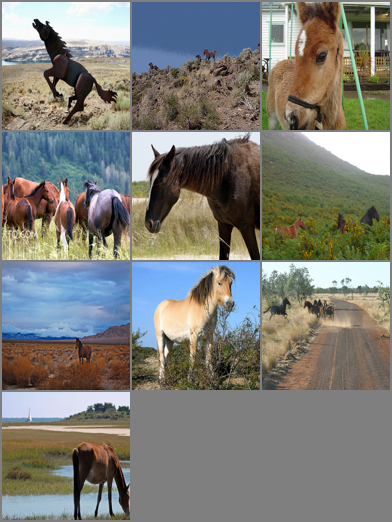

GENERATED B


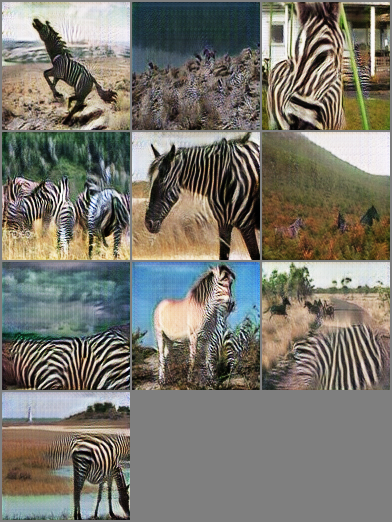

RECONSTRUCTED A


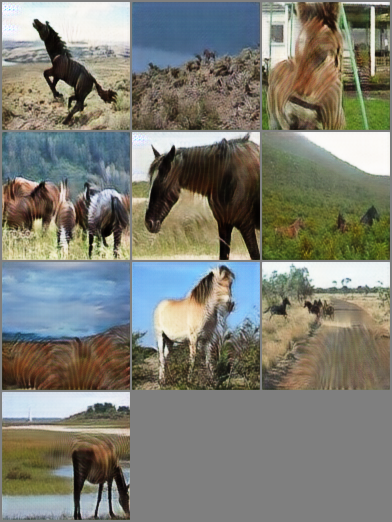

REAL B


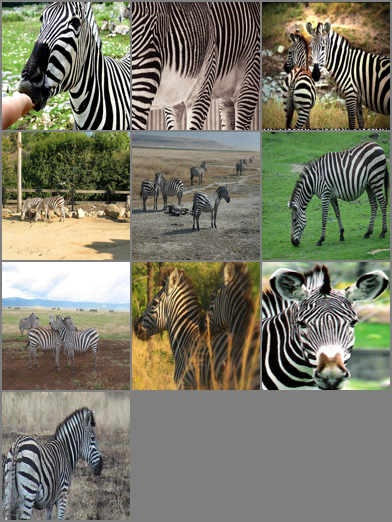

GENERATED A


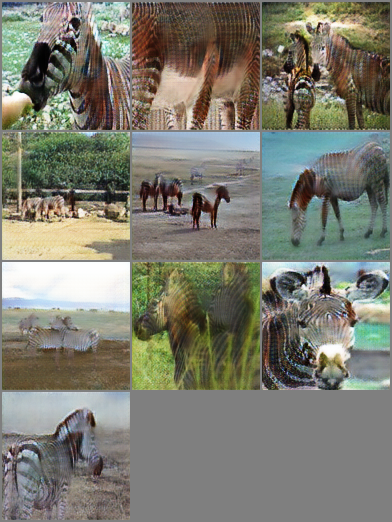

RECONSTRUCTED B


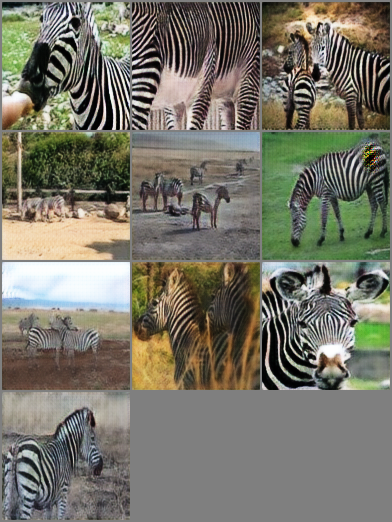

epoch: 60/200, batch: 106/106
       Generator loss: 2.8394603729248047, Discriminator real loss: 0.22045311331748962, Discriminator fake loss: 0.1618686318397522
Time taken (s): 43.62479877471924
epoch: 61/200, batch: 106/106
       Generator loss: 3.3849234580993652, Discriminator real loss: 0.2783198356628418, Discriminator fake loss: 0.11760327219963074
Time taken (s): 43.039159536361694
epoch: 62/200, batch: 106/106
       Generator loss: 2.6175026893615723, Discriminator real loss: 0.1470719426870346, Discriminator fake loss: 0.17558713257312775
Time taken (s): 42.96730399131775
epoch: 63/200, batch: 106/106
       Generator loss: 2.532033920288086, Discriminator real loss: 0.17664553225040436, Discriminator fake loss: 0.17345330119132996
Time taken (s): 43.03209066390991
epoch: 64/200, batch: 106/106
       Generator loss: 2.277872323989868, Discriminator real loss: 0.2165130376815796, Discriminator fake loss: 0.27532297372817993
Time taken (s): 43.03931760787964
REAL A


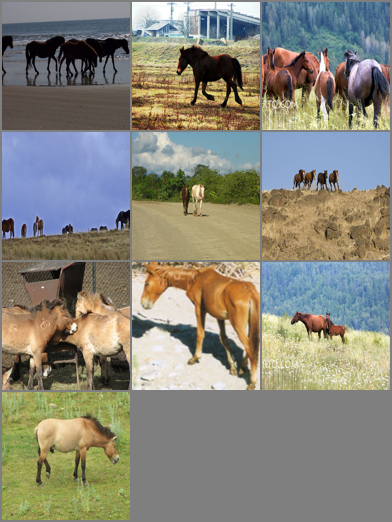

GENERATED B


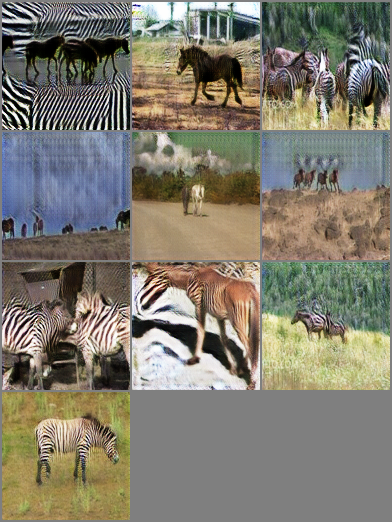

RECONSTRUCTED A


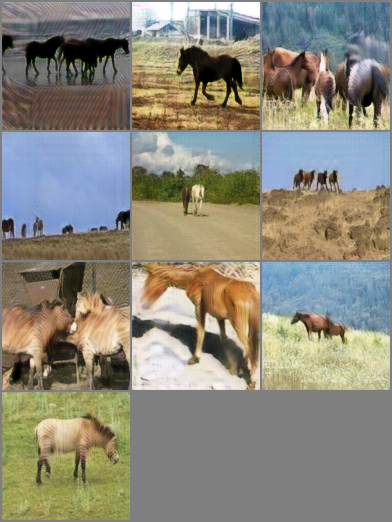

REAL B


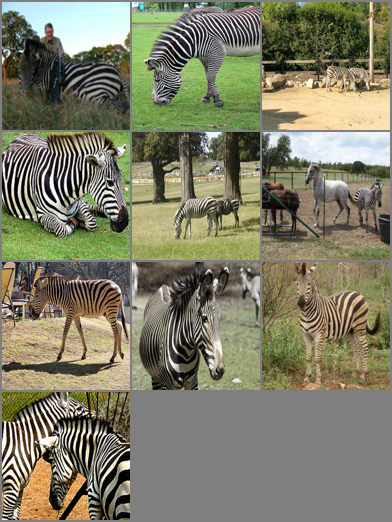

GENERATED A


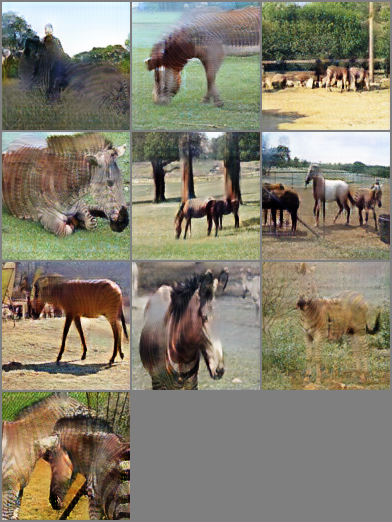

RECONSTRUCTED B


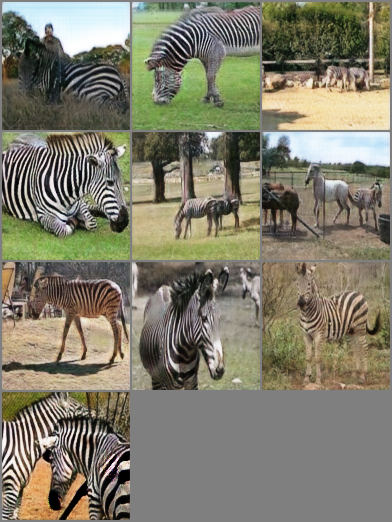

epoch: 65/200, batch: 106/106
       Generator loss: 3.200432777404785, Discriminator real loss: 0.06354820728302002, Discriminator fake loss: 0.10952870547771454
Time taken (s): 43.57701516151428
epoch: 66/200, batch: 106/106
       Generator loss: 2.822171211242676, Discriminator real loss: 0.2270156592130661, Discriminator fake loss: 0.20352132618427277
Time taken (s): 43.012083530426025
epoch: 67/200, batch: 106/106
       Generator loss: 2.9452035427093506, Discriminator real loss: 0.18982727825641632, Discriminator fake loss: 0.18547441065311432
Time taken (s): 42.981905698776245
epoch: 68/200, batch: 106/106
       Generator loss: 2.5931038856506348, Discriminator real loss: 0.050867099314928055, Discriminator fake loss: 0.13107822835445404
Time taken (s): 43.01259136199951
epoch: 69/200, batch: 106/106
       Generator loss: 3.013300895690918, Discriminator real loss: 0.08608527481555939, Discriminator fake loss: 0.0806865245103836
Time taken (s): 42.963953733444214
REAL A


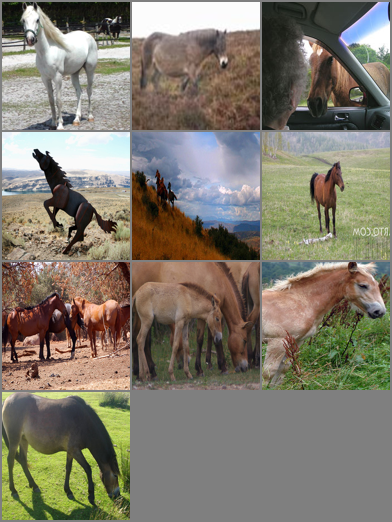

GENERATED B


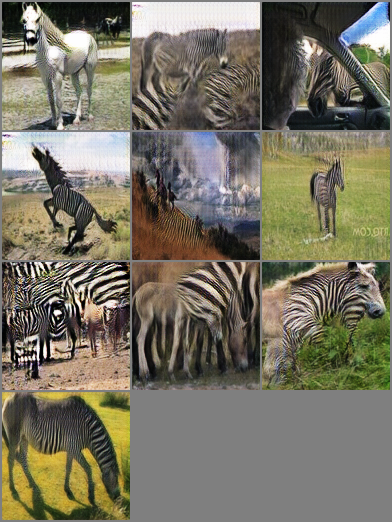

RECONSTRUCTED A


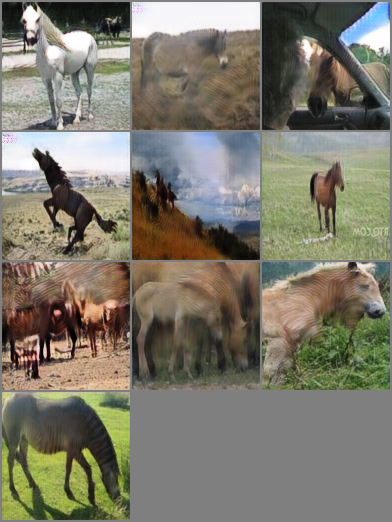

REAL B


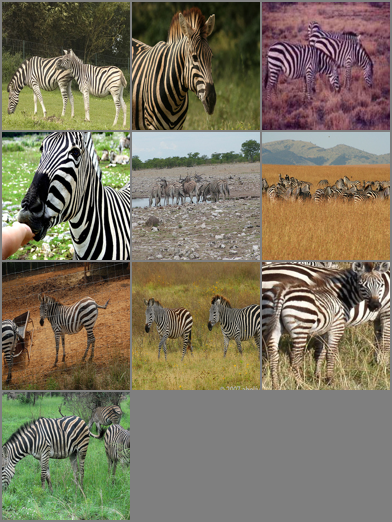

GENERATED A


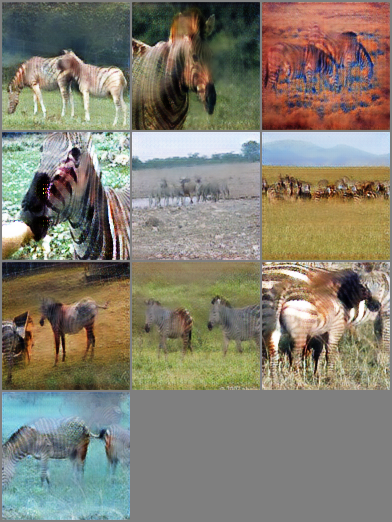

RECONSTRUCTED B


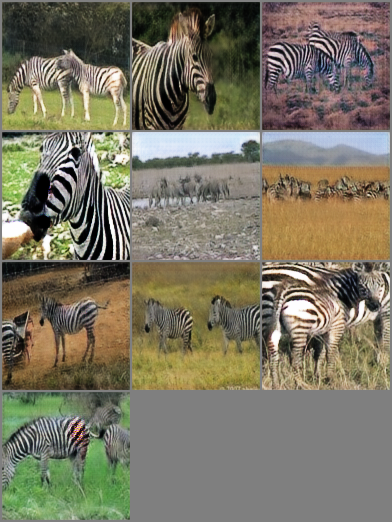

epoch: 70/200, batch: 106/106
       Generator loss: 2.599271297454834, Discriminator real loss: 0.2174074947834015, Discriminator fake loss: 0.1886746734380722
Time taken (s): 43.621662855148315
epoch: 71/200, batch: 106/106
       Generator loss: 2.5562479496002197, Discriminator real loss: 0.281729519367218, Discriminator fake loss: 0.17338624596595764
Time taken (s): 43.01965546607971
epoch: 72/200, batch: 106/106
       Generator loss: 2.683208465576172, Discriminator real loss: 0.2743132412433624, Discriminator fake loss: 0.11904756724834442
Time taken (s): 43.02991080284119
epoch: 73/200, batch: 106/106
       Generator loss: 2.5666849613189697, Discriminator real loss: 0.17359283566474915, Discriminator fake loss: 0.16938897967338562
Time taken (s): 43.02098488807678
epoch: 74/200, batch: 106/106
       Generator loss: 3.028010606765747, Discriminator real loss: 0.12741628289222717, Discriminator fake loss: 0.23985548317432404
Time taken (s): 42.996068477630615
REAL A


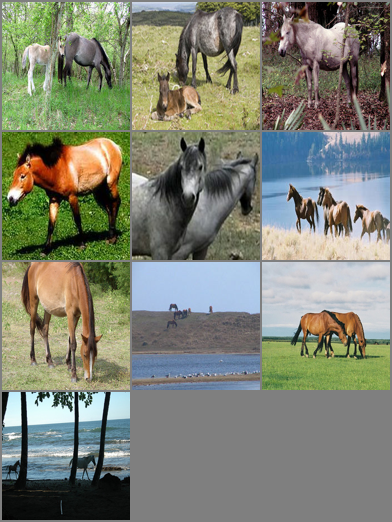

GENERATED B


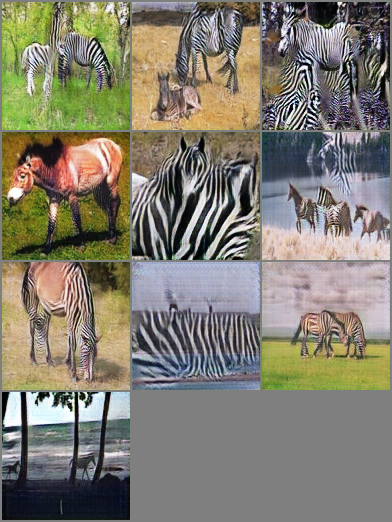

RECONSTRUCTED A


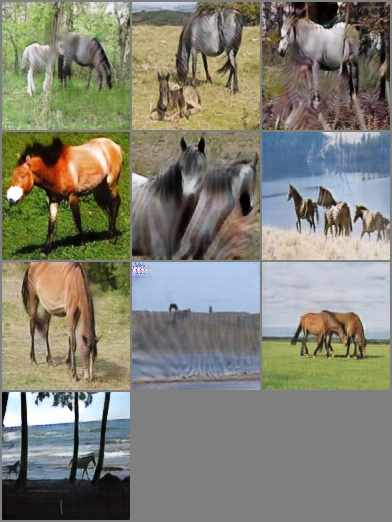

REAL B


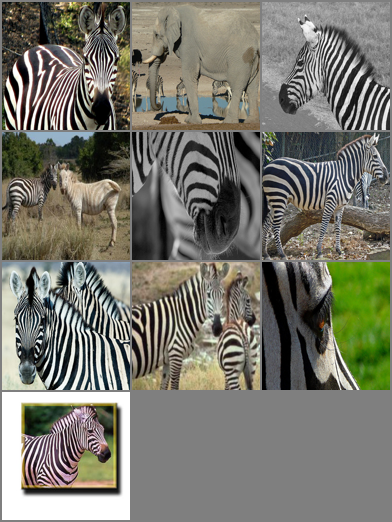

GENERATED A


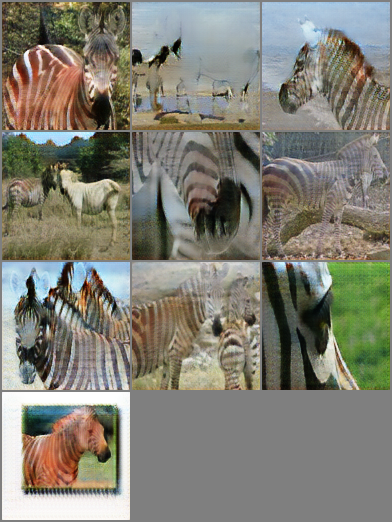

RECONSTRUCTED B


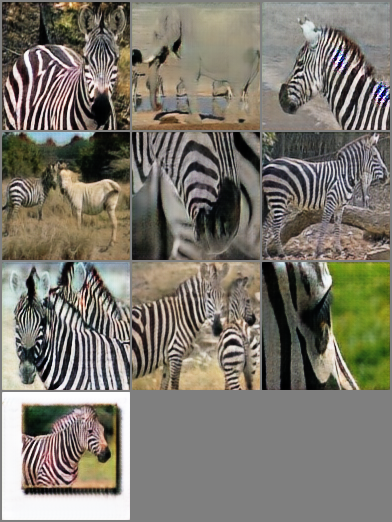

epoch: 75/200, batch: 106/106
       Generator loss: 2.4841012954711914, Discriminator real loss: 0.286307156085968, Discriminator fake loss: 0.1645522117614746
Time taken (s): 43.58597278594971
epoch: 76/200, batch: 106/106
       Generator loss: 2.203362464904785, Discriminator real loss: 0.1252870261669159, Discriminator fake loss: 0.21450302004814148
Time taken (s): 42.972134828567505
epoch: 77/200, batch: 106/106
       Generator loss: 2.7190606594085693, Discriminator real loss: 0.13256274163722992, Discriminator fake loss: 0.0841282457113266
Time taken (s): 43.0100519657135
epoch: 78/200, batch: 106/106
       Generator loss: 2.8975749015808105, Discriminator real loss: 0.07443493604660034, Discriminator fake loss: 0.10381112992763519
Time taken (s): 42.992107629776
epoch: 79/200, batch: 106/106
       Generator loss: 3.198871374130249, Discriminator real loss: 0.16328635811805725, Discriminator fake loss: 0.05566507205367088
Time taken (s): 43.00357484817505
REAL A


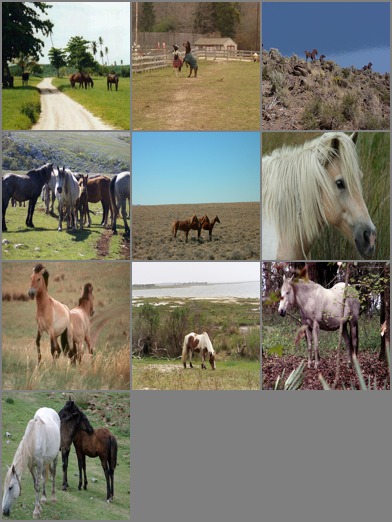

GENERATED B


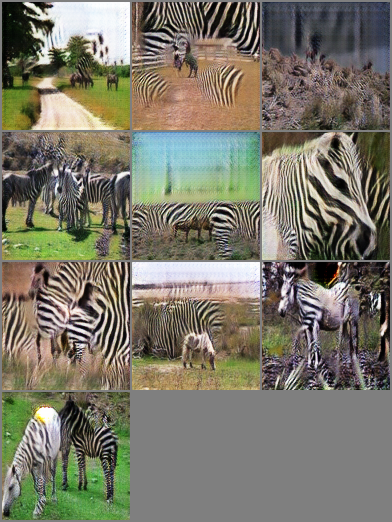

RECONSTRUCTED A


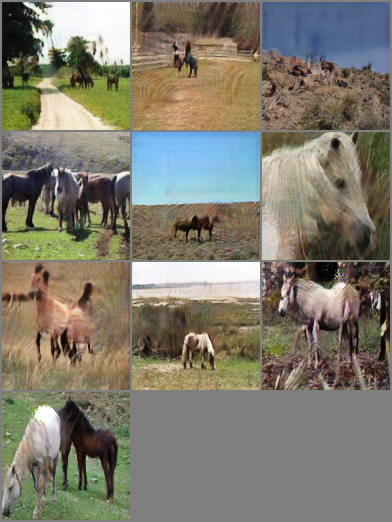

REAL B


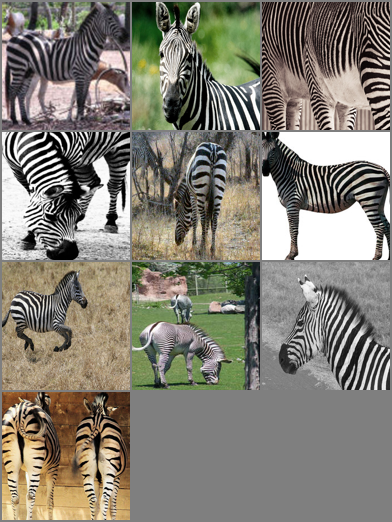

GENERATED A


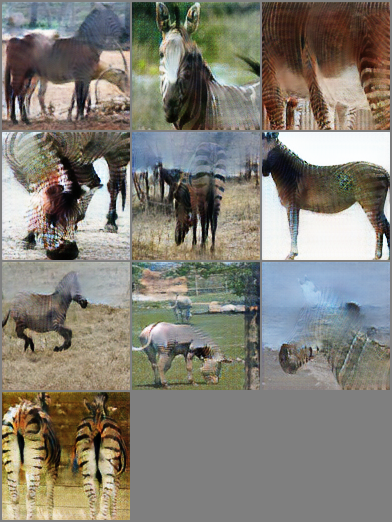

RECONSTRUCTED B


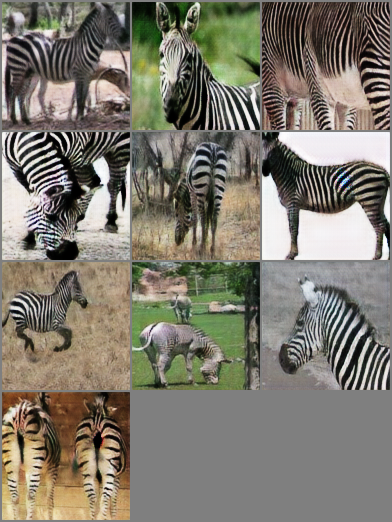

epoch: 80/200, batch: 106/106
       Generator loss: 2.5461525917053223, Discriminator real loss: 0.27075231075286865, Discriminator fake loss: 0.1668069213628769
Time taken (s): 43.630120515823364
epoch: 81/200, batch: 106/106
       Generator loss: 2.4616897106170654, Discriminator real loss: 0.06524927914142609, Discriminator fake loss: 0.17985312640666962
Time taken (s): 42.98884868621826
epoch: 82/200, batch: 106/106
       Generator loss: 2.8006906509399414, Discriminator real loss: 0.03524751961231232, Discriminator fake loss: 0.18255311250686646
Time taken (s): 43.00219511985779


In [ ]:
# Initialize arrays to store losses for plotting
G = []
D_fake = []
D_real = []

if output_test_images:
    !mkdir -p './results'
    !mkdir -p './results/testA'
    !mkdir -p './results/testB'
    output_pathA = './results/testA/'
    output_pathB = './results/testB/'

for epoch in range(num_epochs+1):
    # Start timer
    epoch_time = time.time()

    # Train epoch
    for n_batch, (real_samplesA, real_samplesB) in enumerate(data_loader_train):

        # Prepare batch data
        real_samplesA = Variable(real_samplesA).cuda()
        real_samplesB = Variable(real_samplesB).cuda()

        # Update model weights
        loss_g, loss_d_real, loss_d_fake = model.step_optimization(real_samplesA, real_samplesB)
        
        # Show fake samples
        if n_batch == 10 and (epoch) % 5 == 0 and epoch!=0:
            fakeB = model._generator_AB(real_samplesA)
            reconstructedA = model._generator_BA(fakeB)
            print("REAL A")
            display_batch_images(real_samplesA)
            print("GENERATED B")
            display_batch_images(fakeB.detach())
            print("RECONSTRUCTED A")
            display_batch_images(reconstructedA.detach())
            #
            fakeA = model._generator_BA(real_samplesB)
            reconstructedB = model._generator_AB(fakeA)
            print("REAL B")
            display_batch_images(real_samplesB)
            print("GENERATED A")
            display_batch_images(fakeA.detach())
            print("RECONSTRUCTED B")
            display_batch_images(reconstructedB.detach())

            # Plot losses
            #plot_loss((epoch+1), num_epochs, GA_loss,  GB_loss, DA_loss, DB_loss, CYCA_loss, CYCB_loss, IDTA_loss, IDTB_loss)    

    # Output test images
    if output_test_images and (epoch) % output_test_epoch == 0:
        # Start timer
        output_time = time.time()
        #
        print('Output test images at epoch %s' % epoch)
        for n_batch_test, (samplesA, samplesB) in enumerate(data_loader_test):
            # Prepare batch data
            samplesA = Variable(samplesA).cuda()
            samplesB = Variable(samplesB).cuda()
            #
            fakeA = model._generatorA2B(samplesA)
            cycA = model._generatorB2A(fakeA)
            # Save images
            save_batch_images(fakeA.detach(), output_pathA+'%s_fakeA_epoch%s.png' % (n_batch_test+1, epoch))
            save_batch_images(cycA.detach(), output_pathA+'%s_cycA_epoch%s.png' % (n_batch_test+1, epoch))
            #
            fakeB = model._generatorB2A(samplesB)
            cycB = model._generatorA2B(fakeB)
            # Save images
            save_batch_images(fakeB.detach(), output_pathB+'%s_fakeB_epoch%s.png' % (n_batch_test+1, epoch))
            save_batch_images(cycB.detach(), output_pathB+'%s_cycB_epoch%s.png' % (n_batch_test+1, epoch))
        print(f"Time taken (s): {time.time()-output_time}")

    # Show current loss
    print(f"epoch: {epoch}/{num_epochs}, batch: {n_batch+1}/{len(data_loader_train)}")
    print(f"       Generator loss: {loss_g}, Discriminator real loss: {loss_d_real}, Discriminator fake loss: {loss_d_fake}")
    print(f"Time taken (s): {time.time()-epoch_time}")

    # Array with losses for plotting

    G.append(loss_g)
    D_fake.append(loss_d_fake)
    D_real.append(loss_d_real)